<a href="https://colab.research.google.com/github/kkipngenokoech/Material-Science/blob/main/lab1/code/laboratory1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Install LAMMPS**

In [1]:
%%capture
# Download the files
!wget https://raw.githubusercontent.com/kkipngenokoech/Material-Science/main/lab1/Code/limn2o4.A.in
!wget https://raw.githubusercontent.com/kkipngenokoech/Material-Science/main/lab1/Code/limn2o4.A.data -O limn2o4.data
# Download the vacancy input and data files
!wget https://raw.githubusercontent.com/kkipngenokoech/Material-Science/main/lab1/Code/limn2o4.vac.in -O limn2o4.vac.in
!wget https://raw.githubusercontent.com/kkipngenokoech/Material-Science/main/lab1/Code/limn2o4.vac.data -O limn2o4.vac.data

--2026-02-11 07:47:07--  https://raw.githubusercontent.com/kkipngenokoech/Material-Science/main/lab1/Code/limn2o4.A.in
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 697 [text/plain]
Saving to: ‘limn2o4.A.in’

limn2o4.A.in        100%[===================>]     697  --.-KB/s    in 0s      

2026-02-11 07:47:07 (35.7 MB/s) - ‘limn2o4.A.in’ saved [697/697]

--2026-02-11 07:47:07--  https://raw.githubusercontent.com/kkipngenokoech/Material-Science/main/lab1/Code/limn2o4.A.data
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1923 (1.9

In [2]:
%%capture
!curl -Ls https://micro.mamba.pm/api/micromamba/linux-64/latest | tar -xvj bin/micromamba
!./bin/micromamba create -y -n lmp -c conda-forge python=3.11 "lammps=*=*nompi*"

**Install ASE**

In [3]:
%%capture
!pip -q install ase

**Import Libraries**

In [28]:
from matplotlib import pyplot as plt
import numpy as np
from ase.io import read
from ase.visualize.plot import animate, plot_atoms
from matplotlib import rc
import warnings
import pandas as pd

**Define function to read LAMMPS log files**

In [5]:
def read_lammps_log(filename):
    data = {}
    reading = False

    with open(filename) as f:
        for line in f:
            line = line.strip()
            if line.startswith("Step"):
                headers = line.split()
                data = {h: [] for h in headers}
                reading = True
                continue
            if line.startswith("Loop time"):
                for h in headers:
                    data[h] = np.array(data[h])
                break
            if reading and line:
                values = line.split()
                for h, v in zip(headers, values):
                    data[h].append(float(v))

    return data

## Argon

In [6]:
# %%writefile in.melt
# # 1. Setup the world
# units           lj
# atom_style      atomic
# lattice         fcc 0.8442
# region          box block 0 10 0 10 0 10
# create_box      1 box
# create_atoms    1 box
# mass            1 1.0

# # 2. Setup the physics (Lennard-Jones)
# pair_style      lj/cut 2.5
# pair_coeff      1 1 1.0 1.0 2.5

# # 3. Run the simulation
# velocity        all create 1.44 87287
# fix             1 all nve
# thermo          100
# run             1000

In [7]:
# %%bash
# ./bin/micromamba run -n lmp python - << 'PY'
# from lammps import lammps
# lmp = lammps(cmdargs=["-screen", "none", "-log", "log.lammps"])
# lmp.file("in.melt")
# lmp.close()
# PY

In [8]:
# # Read the log file generated by your simulation
# data = read_lammps_log("log.lammps")

# # Plot Temperature to see it stabilize or change
# plt.figure(figsize=(8, 5))
# plt.plot(data["Step"], data["Temp"], color='red')
# plt.xlabel("Simulation Step")
# plt.ylabel("Temperature (LJ Units)")
# plt.title("System Temperature Over Time")
# plt.show()

## **Launch Simulation**

Upload *limn2o4.in* and *limn2o4.data* using the **Files** tab at the left. Double-click a file to view/modify its contents.

You can learn more about running LAMMPS through the Python module [here](https://docs.lammps.org/Python_launch.html), and about modifying input parameters [here](https://docs.lammps.org/Python_module.html).


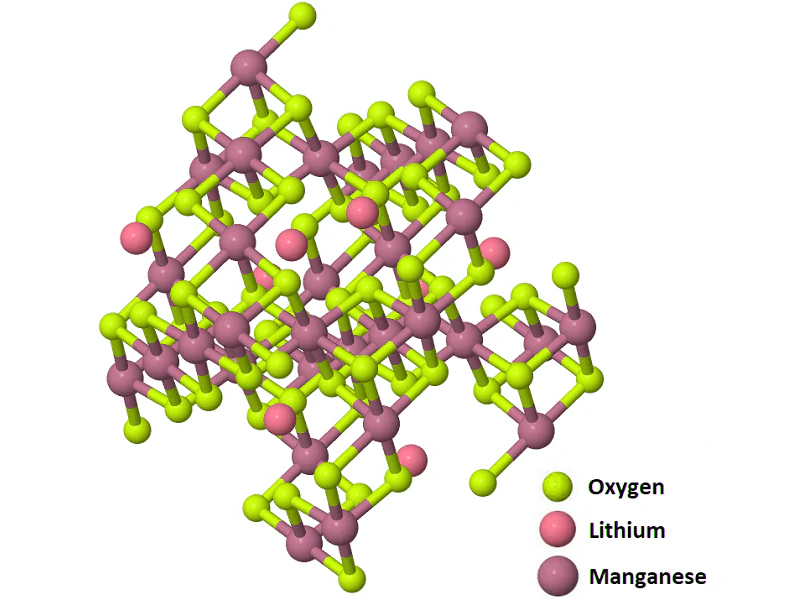

In [9]:
!cat /content/limn2o4.data

Structure of LiMn2O4
 
      56     atoms
 
         3    atom types
 
       0.000000      8.2500000 xlo xhi
       0.000000      8.2500000 ylo yhi
       0.000000      8.2500000 zlo zhi
 
              Masses
 
         1            6.941
         2           54.938
         3           15.999
               Atoms

 1 1 8.23585 8.23314 0.00176909
 2 1 4.11085 4.10814 0.00177939
 3 1 8.23585 4.10814 4.12677
 4 1 4.11085 8.23315 4.12677
 5 1 6.17335 2.04564 6.18928
 6 1 2.04835 2.04564 2.06427
 7 1 2.04836 6.17064 6.18927
 8 1 6.17335 6.17064 2.06427
 9 2 1.0171 1.0144 5.15803
10 2 5.14211 5.13939 5.15802
11 2 7.2046 3.07689 1.03302
12 2 3.0796 5.1394 3.09552
13 2 3.07961 1.01439 7.22052
14 2 5.14211 7.20189 7.22052
15 2 1.0171 7.2019 3.09552
16 2 5.1421 1.01438 1.03302
17 2 3.0796 3.0769 5.15802
18 2 7.2046 5.13938 7.22052
19 2 1.0171 5.13939 1.03302
20 2 5.14209 3.07689 3.09552
21 2 7.20461 7.20189 5.15802
22 2 3.0796 7.20189 1.03302
23 2 1.01711 3.0769 7.22052
24 2 7.2046 1.01439 3.

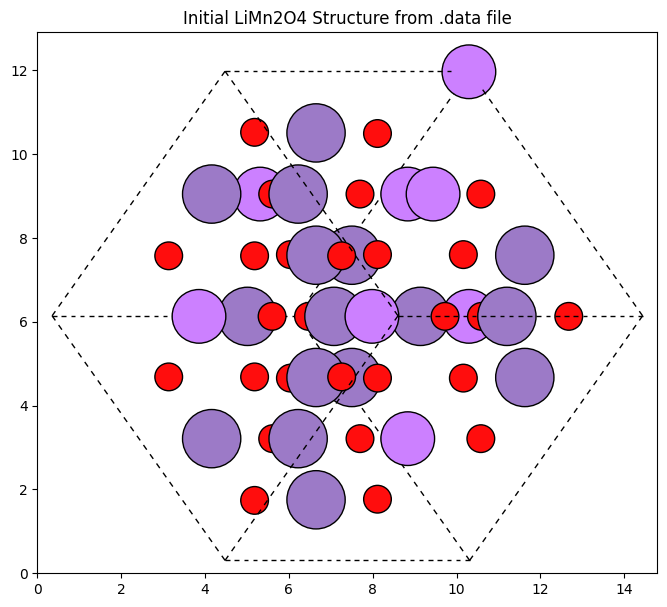

In [16]:

# Read the LAMMPS data file
# Note: 'lammps-data' is the format, 'style' should match your atom_style (likely 'atomic')
struct = read('limn2o4.data', format='lammps-data', style='atomic')

# Plot the structure
fig, ax = plt.subplots(figsize=(8, 8))
plot_atoms(struct, ax, radii=0.5, rotation='45x,45y,0z')
ax.set_title("Initial LiMn2O4 Structure from .data file")
plt.show()

[commands](https://docs.lammps.org/Commands_all.html)

In [10]:
!cat /content/limn2o4.A.in

units           metal

dimension       3
boundary        p p p
atom_style      atomic
neighbor        2.5 bin
neigh_modify    every 1

read_data       limn2o4.data
pair_style      lj/cut 16.5
pair_coeff      1 1 0.249 3.57 16.5
pair_coeff      1 2 0.292 3.25 16.5
pair_coeff      1 3 0.195 1.77 16.5
pair_coeff      2 2 0.204 2.91 16.5
pair_coeff      2 3 0.226 2.06 12.0
pair_coeff      3 3 0.204 2.91 12.0

run_style       verlet
timestep        0.0005
fix             1 all nve
velocity        all create 5000 9865758 dist uniform

dump            1 all xyz 1 limn2o4.xyz
dump_modify     1 element Li Mn O

thermo          1
thermo_style    custom step time ke pe etotal

run             10000


In [11]:
%%bash
./bin/micromamba run -n lmp python - << 'PY'
from lammps import lammps
lmp = lammps(cmdargs=["-screen", "none", "-log", "log.lammps"])
lmp.file("/content/limn2o4.A.in")
lmp.command("timestep  0.0005")
lmp.command("run  10000")
lmp.close()
PY

**Plot Results**

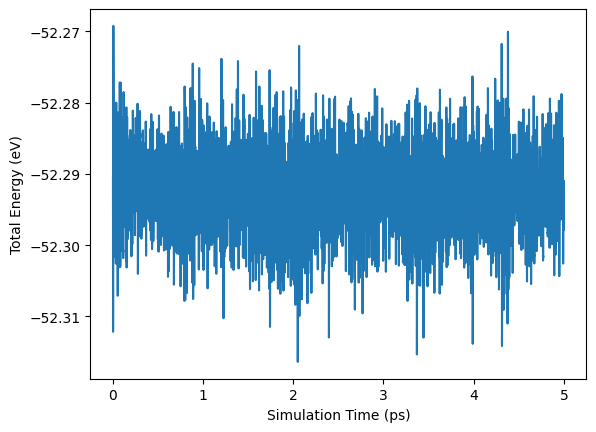

In [12]:
data = read_lammps_log("log.lammps")
plt.plot(data["Time"], data["TotEng"])
plt.xlabel("Simulation Time (ps)")
plt.ylabel("Total Energy (eV)");

In [25]:
!cat /content/log.lammps

Streaming output truncated to the last 5000 lines.
     15028   7.514          18.176363     -70.47233      -52.295968    
     15029   7.5145         18.199719     -70.495309     -52.29559     
     15030   7.515          18.193205     -70.485669     -52.292464    
     15031   7.5155         18.191453     -70.479997     -52.288543    
     15032   7.516          18.242299     -70.526875     -52.284576    
     15033   7.5165         18.396875     -70.678658     -52.281784    
     15034   7.517          18.69382      -70.973017     -52.279197    
     15035   7.5175         19.142626     -71.423834     -52.281208    
     15036   7.518          19.714638     -72.001205     -52.286568    
     15037   7.5185         20.348061     -72.639616     -52.291556    
     15038   7.519          20.965049     -73.260702     -52.295654    
     15039   7.5195         21.491557     -73.790235     -52.298678    
     15040   7.52           21.870988     -74.170618     -52.29963     
     15041   

In [27]:
!head -n 100 /content/log.lammps

LAMMPS (29 Aug 2024)
OMP_NUM_THREADS environment is not set. Defaulting to 1 thread. (src/comm.cpp:98)
  using 1 OpenMP thread(s) per MPI task
units           metal

dimension       3
boundary        p p p
atom_style      atomic
neighbor        2.5 bin
neigh_modify    every 1

read_data       limn2o4.data
Reading data file ...
  orthogonal box = (0 0 0) to (8.25 8.25 8.25)
  1 by 1 by 1 MPI processor grid
  reading atoms ...
  56 atoms
  read_data CPU = 0.001 seconds
pair_style      lj/cut 16.5
pair_coeff      1 1 0.249 3.57 16.5
pair_coeff      1 2 0.292 3.25 16.5
pair_coeff      1 3 0.195 1.77 16.5
pair_coeff      2 2 0.204 2.91 16.5
pair_coeff      2 3 0.226 2.06 12.0
pair_coeff      3 3 0.204 2.91 12.0

run_style       verlet
timestep        0.0005
fix             1 all nve
velocity        all create 5000 9865758 dist uniform

dump            1 all xyz 1 limn2o4.xyz
dump_modify     1 element Li Mn O

thermo          1
thermo_style    custom step time ke pe etotal

run             1

In [30]:
log_data = read_lammps_log("log.lammps")
df = pd.DataFrame(log_data)
df.head()

,Step,Time,KinEng,PotEng,TotEng
0,0.0,0.0000,35.546540,-87.836843,-52.290303
1,1.0,0.0005,35.180949,-87.480047,-52.299099
2,2.0,0.0010,34.099757,-86.406635,-52.306878
3,3.0,0.0015,32.356936,-84.669092,-52.312157
4,4.0,0.0020,30.055749,-82.364712,-52.308964


In [32]:
total_energy = df['TotEng']
fluctuation = total_energy.max() - total_energy.min()
fluctuation

0.04716200000000015

### changing timesteps

**Create Animation**


number of frames = 2001


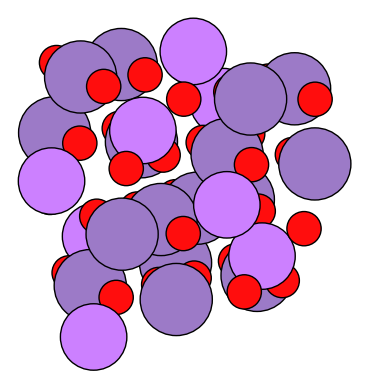

In [17]:
xyz = read("limn2o4.xyz",index='::10')
print("number of frames =", len(xyz))
warnings.filterwarnings('ignore')
rc("animation", html="jshtml")
animate(xyz, radii=0.8, rotation=("10x, 20y, 0z"))

**Launch Simulation with Vacancies**

Upload *limn2o4.vac.in* and *limn2o4.vac.data* using the **Files** tab at the left. Double-click a file to view/modify its contents.

In [19]:
!cat /content/limn2o4.vac.data

Structure of LiMn2O4
 
      52    atoms
 
         3    atom types
 
       0.000000      8.2500000 xlo xhi
       0.000000      8.2500000 ylo yhi
       0.000000      8.2500000 zlo zhi
 
              Masses
 
         1            6.941
         2           54.938
         3           15.999
               Atoms

 1 1 4.11085 4.10814 0.00177939         
 2 1 8.23585 4.10814 4.12677
 3 1 4.11085 8.23315 4.12677
 4 1 6.17335 2.04564 6.18928
 5 2 1.0171 1.0144 5.15803
 6 2 5.14211 5.13939 5.15802
 7 2 7.2046 3.07689 1.03302
 8 2 3.0796 5.1394 3.09552
 9 2 3.07961 1.01439 7.22052
10 2 5.14211 7.20189 7.22052
11 2 1.0171 7.2019 3.09552
12 2 5.1421 1.01438 1.03302
13 2 3.0796 3.0769 5.15802
14 2 7.2046 5.13938 7.22052
15 2 1.0171 5.13939 1.03302
16 2 5.14209 3.07689 3.09552
17 2 7.20461 7.20189 5.15802
18 2 3.0796 7.20189 1.03302
19 2 1.01711 3.0769 7.22052
20 2 7.2046 1.01439 3.09553
21 3 1.02723 1.02452 3.08539
22 3 7.19448 3.06676 7.2104
23 3 3.06948 5.14952 5.16815
24 3 5.15223 7.1917

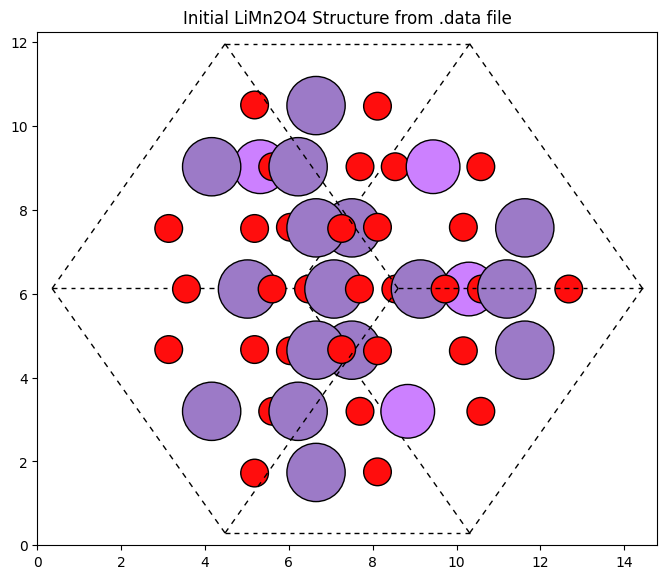

In [18]:
# Read the LAMMPS data file
# Note: 'lammps-data' is the format, 'style' should match your atom_style (likely 'atomic')
struct = read('limn2o4.vac.data', format='lammps-data', style='atomic')

# Plot the structure
fig, ax = plt.subplots(figsize=(8, 8))
plot_atoms(struct, ax, radii=0.5, rotation='45x,45y,0z')
ax.set_title("Initial LiMn2O4 Structure from .data file")
plt.show()

In [20]:
!cat /content/limn2o4.vac.in

units           metal

dimension       3
boundary        p p p
atom_style      atomic
neighbor        2.5 bin
neigh_modify    every 1

read_data       limn2o4.vac.data
pair_style      lj/cut 16.5
pair_coeff      1 1 0.249 3.57 16.5
pair_coeff      1 2 0.292 3.25 16.5
pair_coeff      1 3 0.195 1.77 16.5
pair_coeff      2 2 0.204 2.91 16.5
pair_coeff      2 3 0.226 2.06 12.0
pair_coeff      3 3 0.204 2.91 12.0

timestep        0.0005
fix             1 all nvt temp 10000 10000 0.05
velocity        all create 10000 9865758 dist uniform

dump            1 all xyz 1000 limn2o4.vac.xyz
dump_modify     1 element Li Mn O

group           lithiums type 1
group           manganeses type 2
group           oxygens type 2
compute         mymsdli lithiums msd com yes 
compute         mymsdmn manganeses msd com yes 
compute         mymsdo oxygens msd com yes 

thermo          1000
thermo_style    custom step time temp c_mymsdli[4] c_mymsdmn[4] c_mymsdo[4]

#run             1000000


In [21]:
%%bash
./bin/micromamba run -n lmp python - << 'PY'
from lammps import lammps
lmp = lammps(cmdargs=["-screen", "none", "-log", "log.vac.lammps"])
lmp.file("/content/limn2o4.vac.in")
lmp.command("timestep  0.001")
lmp.command("run  1000000")
lmp.close()
PY

**Plot Results**

In [ ]:
data = read_lammps_log("log.vac.lammps")
plt.plot(data["Time"], data["Temp"])
plt.xlabel("Simulation Time (ps)")
plt.ylabel("Temperature (K)");

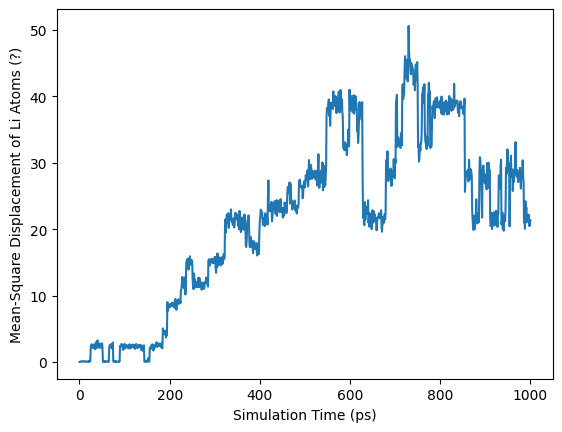

In [36]:
data = read_lammps_log("log.vac.lammps")
plt.plot(data["Time"], data["c_mymsdli[4]"])
plt.xlabel("Simulation Time (ps)")
plt.ylabel("Mean-Square Displacement of Li Atoms (?)");

**Create Animation**

In [ ]:
xyz = read("limn2o4.vac.xyz",index='::10')
print("number of frames =", len(xyz))
warnings.filterwarnings('ignore')
rc("animation", html="jshtml")
animate(xyz, radii=0.8, rotation=("10x, 20y, 0z"))

## Q3

In [33]:
%%capture
# Download the files
!wget https://raw.githubusercontent.com/kkipngenokoech/Material-Science/main/lab1/Code/limn2o4.B.in
!wget https://raw.githubusercontent.com/kkipngenokoech/Material-Science/main/lab1/Code/limn2o4.B.data

In [34]:
!cat /content/limn2o4.B.data

Structure of LiMn2O4
 
      52    atoms
 
         3    atom types
 
       0.000000      8.2500000 xlo xhi
       0.000000      8.2500000 ylo yhi
       0.000000      8.2500000 zlo zhi
 
              Masses
 
         1            6.941
         2           54.938
         3           15.999
               Atoms

 1 1 4.11085 4.10814 0.00177939         
 2 1 8.23585 4.10814 4.12677
 3 1 4.11085 8.23315 4.12677
 4 1 6.17335 2.04564 6.18928
 5 2 1.0171 1.0144 5.15803
 6 2 5.14211 5.13939 5.15802
 7 2 7.2046 3.07689 1.03302
 8 2 3.0796 5.1394 3.09552
 9 2 3.07961 1.01439 7.22052
10 2 5.14211 7.20189 7.22052
11 2 1.0171 7.2019 3.09552
12 2 5.1421 1.01438 1.03302
13 2 3.0796 3.0769 5.15802
14 2 7.2046 5.13938 7.22052
15 2 1.0171 5.13939 1.03302
16 2 5.14209 3.07689 3.09552
17 2 7.20461 7.20189 5.15802
18 2 3.0796 7.20189 1.03302
19 2 1.01711 3.0769 7.22052
20 2 7.2046 1.01439 3.09553
21 3 1.02723 1.02452 3.08539
22 3 7.19448 3.06676 7.2104
23 3 3.06948 5.14952 5.16815
24 3 5.15223 7.1917

In [35]:
!cat limn2o4.B.in

units           metal

dimension       3
boundary        p p p
atom_style      atomic
neighbor        2.5 bin
neigh_modify    every 1

read_data       limn2o4.vac.data
pair_style      lj/cut 16.5
pair_coeff      1 1 0.249 3.57 16.5
pair_coeff      1 2 0.292 3.25 16.5
pair_coeff      1 3 0.195 1.77 16.5
pair_coeff      2 2 0.204 2.91 16.5
pair_coeff      2 3 0.226 2.06 12.0
pair_coeff      3 3 0.204 2.91 12.0

timestep        0.0005
fix             1 all nvt temp 10000 10000 0.05
velocity        all create 10000 9865758 dist uniform

dump            1 all xyz 1000 limn2o4.xyz
dump_modify     1 element Li Mn O

group           lithiums type 1
group           manganeses type 2
group           oxygens type 2
compute         mymsdli lithiums msd com yes 
compute         mymsdmn manganeses msd com yes 
compute         mymsdo oxygens msd com yes 

thermo          1000
thermo_style    custom step time temp c_mymsdli[4] c_mymsdmn[4] c_mymsdo[4]

run             1000000


In [ ]:
%%bash
./bin/micromamba run -n lmp python - << 'PY'
from lammps import lammps
lmp = lammps(cmdargs=["-screen", "none", "-log", "log.vac.lammps"])
lmp.file("/content/limn2o4.vac.in")
lmp.command("timestep  0.001")
lmp.command("run  1000000")
lmp.close()
PY